In [2]:
%matplotlib inline

import requests
import os
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, MultiPolygon
import folium 
import matplotlib.pyplot as plt
from cartopy.feature import ShapelyFeature
import cartopy.crs as ccrs
import matplotlib.patches as mpatches
from folium.plugins import FeatureGroupSubGroup, MarkerCluster, Search, Geocoder
from geopy.geocoders import Nominatim
from matplotlib import pyplot as plt
import folium.plugins as plugins


plt.ion() # interactive plotting


In [2]:
###---1.0---###

# Load OS Grid Ref CSV and Storm Overflow Annual Return .xlsx file
sewers = pd.read_csv('os_grid_ref.csv')
excel_file = 'EDM 2022 Storm Overflow Annual Return - all water and sewerage companies.xlsx'
spilltime_all = pd.concat(pd.read_excel(excel_file, sheet_name=None).values(), ignore_index=True)

# Change name of spilltime .xls column 'EA Permit Reference (EA Consents Database) to 'PERMIT_NUMBER'
spilltime_all.columns = spilltime_all.columns.str.replace("EA Permit Reference (EA Consents Database)", "PERMIT_NUMBER")

# save spilltime_all xlsx as a csv file for merge function
spilltime_all.to_csv('spilltime_all.csv', encoding='utf-8')

# Move the column name from the second row of the spilltime_all.csv file and set this as the column name, to allow the
# merge function to take place for both csv files
spilltime_all.columns = spilltime_all.iloc[0]

# remove the second row as this is no longer needed
spilltime_all = spilltime_all.drop(index=1)

# Change the name of the column called 'EA Permit Reference\n(EA Consents Database)' to 'PERMIT_NUMBER' to allow for
# a merge of both csv files
spilltime_all = spilltime_all.rename(columns={'EA Permit Reference\n(EA Consents Database)': 'PERMIT_NUMBER'})

# Merge both csv files using 'PERMIT_NUMBER' as a common column
sewers_spilltime = pd.merge(sewers, spilltime_all, on='PERMIT_NUMBER')

# Remove columns no longer needed for later analysis
sewers_spilltime = sewers_spilltime.drop(
    columns=['EFFLUENT_GRID_REF', 'DISCHARGE_SITE_TYPE_CODE', 'DISTRICT_COUNCIL', 'CATCHMENT_CODE', 'EA_REGION',
             'PERMIT_VERSION', 'RECEIVING_ENVIRON_TYPE_CODE', 'REC_ENV_CODE_DESCRIPTION', 'ISSUED_DATE',
             'EFFECTIVE_DATE', 'REVOCATION_DATE', 'STATUS_OF_PERMIT', 'STATUS_DESCRIPTION', 'OUTLET_NUMBER',
             'OUTLET_TYPE_CODE', 'OUTLET_GRID_REF', 'EFFLUENT_NUMBER', 'Water Company Name',
             'Site Name\n(EA Consents Database)',
             'Site Name\n(WaSC operational)\n[optional]', 'WaSC Supplementary Permit Ref.\n[optional]',
             'Activity Reference on Permit', 'Storm Discharge Asset Type',
             'Outlet Discharge NGR\n(EA Consents Database)',
             'WFD Waterbody ID (Cycle 2)\n(discharge outlet)',
             'WFD Waterbody Catchment Name (Cycle 2)\n(discharge outlet)',
             'Receiving Water / Environment (common name)\n(EA Consents Database)',
             'Shellfish Water (only populate for storm overflow with a Shellfish Water EDM requirement)',
             'Treatment Method\n(over & above Storm Tank settlement / screening)', 'Initial EDM Commission Date',
             'EDM Operation -\n% of reporting period EDM operational',
             'EDM Operation -\nReporting % -\nPrimary Reason <90%',
             'EDM Operation -\nAction taken / planned -\nStatus & timeframe',
             'High Spill Frequency -\nOperational Review -\nPrimary Reason',
             'High Spill Frequency -\nAction taken / planned -\nStatus & timeframe',
             'High Spill Frequency -\nEnvironmental Enhancement -\nPlanning Position (Hydraulic capacity)'])

# Split lat long data stored in 'DISCHARGE_NGR' column into two seperate columns, to allow conversion to shapefile
# for use with Folium
sewers_spilltime = sewers_spilltime.assign(lon=sewers_spilltime['DISCHARGE_NGR'].str.split(',').str[0],
                                           lat=sewers_spilltime['DISCHARGE_NGR'].str.split(',').str[1])

sewers_spilltime['geometry'] = list(zip(sewers_spilltime['lon'], sewers_spilltime['lat']))
sewers_spilltime['geometry'] = sewers_spilltime['geometry'].apply(Point)

# Delete the 'DISCHARGE_NGR' column
sewers_spilltime.drop('DISCHARGE_NGR', axis=1, inplace=True)

# save the merged and cleaned DataFrame to a new csv file for use with folium
sewers_spilltime.to_csv('sewers_spill_merged.csv', index=False)

In [3]:
###---2.0---###

# Read the new dataframe and convert lat lon into a single coumn called geometry and apply as a point (instead of tuple)
spm = pd.read_csv('sewers_spill_merged.csv')
spm['geometry'] = list(zip(sewers_spilltime['lon'], sewers_spilltime['lat']))
spm['geometry'] = spm['geometry'].apply(Point)

# Drop columns not requried within map
spm = spm.drop(columns=['ADD_OF_DISCHARGE_SITE_LINE_1', 'ADD_OF_DISCHARGE_SITE_LINE_2',
       'ADD_OF_DISCHARGE_SITE_LINE_3', 'ADD_OF_DISCHARGE_SITE_LINE_4',
       'ADD_OF_DISCHARGE_SITE_PCODE', 'Unnamed: 20'])

# Create a new GeoDataFrame from the dataframe spm
gdf = gpd.GeoDataFrame(spm)
gdf.set_crs("EPSG:4326", inplace=True)

# Save the updated spm geodataframe with correct crs         
gdf.to_file('spm_points.shp')

Index(['COMPANY_NAME', 'DSI_TYPE_DESCRIPTION', 'DISCHARGE_SITE_NAME',
       'CATC_NAME', 'SOURCE', 'PERMIT_NUMBER', 'RECEIVING_WATER',
       'OUTLET_TYPE_DESCRIPTION', 'EFFLUENT_TYPE', 'EFF_TYPE_DESCRIPTION',
       'Bathing Water (only populate for storm overflow with a Bathing Water EDM requirement)',
       'Total Duration (hrs) all spills prior to processing through 12-24h count method',
       'Counted spills using 12-24h count method',
       'Long-term average spill count', 'No. full years EDM data\n(years)',
       'lon', 'lat', 'geometry'],
      dtype='object')


C:\Users\sprou\AppData\Local\Temp\ipykernel_8852\806431812.py:19: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  gdf.to_file('spm_points.shp')
C:\Users\sprou\anaconda3\envs\sewer\Lib\site-packages\pyogrio\raw.py:456: RuntimeWarning: Normalized/laundered field name: 'COMPANY_NAME' to 'COMPANY_NA'
  ogr_write(
C:\Users\sprou\anaconda3\envs\sewer\Lib\site-packages\pyogrio\raw.py:456: RuntimeWarning: Normalized/laundered field name: 'DSI_TYPE_DESCRIPTION' to 'DSI_TYPE_D'
  ogr_write(
C:\Users\sprou\anaconda3\envs\sewer\Lib\site-packages\pyogrio\raw.py:456: RuntimeWarning: Normalized/laundered field name: 'DISCHARGE_SITE_NAME' to 'DISCHARGE_'
  ogr_write(
C:\Users\sprou\anaconda3\envs\sewer\Lib\site-packages\pyogrio\raw.py:456: RuntimeWarning: Normalized/laundered field name: 'PERMIT_NUMBER' to 'PERMIT_NUM'
  ogr_write(
C:\Users\sprou\anaconda3\envs\sewer\Lib\site-packages\pyogrio\raw.py:456: RuntimeWarning: Normalized/laundered field n

float64
count    12862.000000
mean       148.803014
std        361.631534
min          0.000000
25%          1.250000
50%         20.797083
75%        124.452500
max       6896.200000
Name: Total Dura, dtype: float64


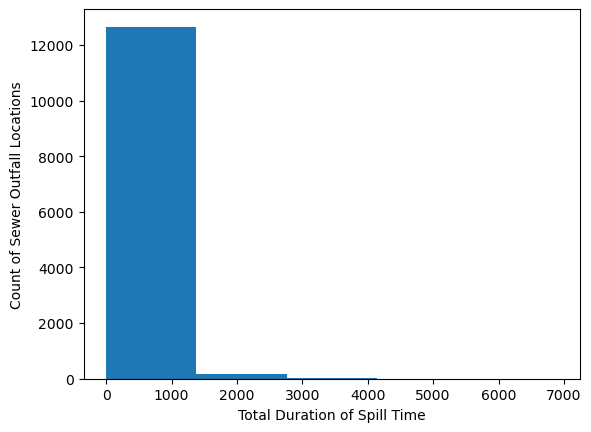

In [10]:
###---3.0---###

# Script to look into the total dura column to create an appropriate interval range for displaying marker colours 
gdf = gpd.read_file("spm_points.shp")


gdf['Total Dura'] = pd.to_numeric(gdf['Total Dura'], errors='coerce')
print(gdf['Total Dura'].dtype)

gdf['Total Dura'].plot(kind='hist', bins=5)


plt.xlabel('Total Duration of Spill Time')
plt.ylabel('Count of Sewer Outfall Locations')



print(gdf['Total Dura'].describe())

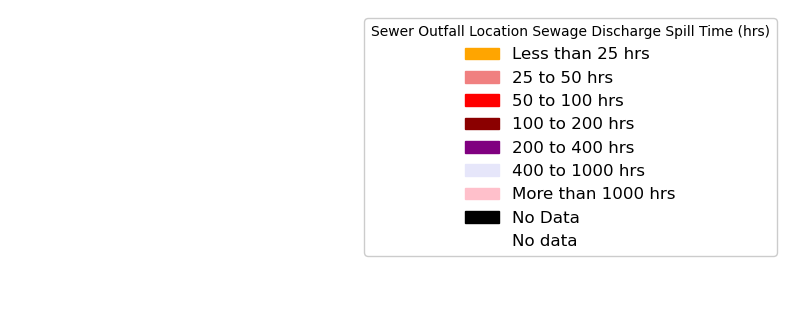

C:\Users\sprou\AppData\Local\Temp\ipykernel_3168\2326159274.py:77: UserWarning: color argument of Icon should be one of: {'black', 'pink', 'beige', 'white', 'lightblue', 'lightred', 'red', 'lightgreen', 'green', 'darkgreen', 'orange', 'darkblue', 'blue', 'lightgray', 'gray', 'cadetblue', 'darkred', 'purple', 'darkpurple'}.
  folium.Marker(location=[row['lat'], row['lon']], icon=folium.Icon(color=marker_color), popup=folium.Popup(tooltip, max_width=300)).add_to(marker_cluster)


In [4]:
###---4.0---###

# Load sewer location point data 
spm_points = gpd.read_file('spm_points.shp')

# Read the bathing water files
bw1 = pd.read_csv('site1.csv')
bw2 = pd.read_csv('site2.csv')

# Merge both files and remove the duplicates where necessary 
bw = pd.concat([bw1, bw2], ignore_index=True).drop_duplicates(subset=['label'])

# Create the map, centred on Bristol 
m = folium.Map(location=[51.45195626022765, -2.6029620182152975], zoom_start=20)

# Add the spm points to the map
marker_cluster = MarkerCluster(name="Sewer Outfall Location").add_to(m)
    
# Add a legend to the map
legend_items = {
    'orange': 'Less than 25 hrs',
    'lightcoral': '25 to 50 hrs',
    'red': '50 to 100 hrs',
    'darkred': '100 to 200 hrs',
    'purple': '200 to 400 hrs',
    'lavender': '400 to 1000 hrs',
    'pink': 'More than 1000 hrs',
    'black': 'No Data',
}

legend_patches = []
for color, label in legend_items.items():
    legend_patches.append(mpatches.Patch(color=color, label=label))

legend = mpatches.Patch(color='white', label='No data')
legend_patches.append(legend)

plt.figure(figsize=(10, 4))
plt.legend(handles=legend_patches, fontsize=12, framealpha=1, title='Sewer Outfall Location Sewage Discharge Spill Time')
plt.axis('off')
plt.show()

# Create the intervals and display colour for the sewer outfall locations based on the total dura value
def get_marker_color(value):
    if pd.isnull(value) or value in ('N/a', '-'):
        return 'black'
    try:
        value = float(value)
        if value <= 0:
            return 'black'
        elif 1 < value < 25:
            return 'orange'
        elif value < 50:
            return 'lightcoral'
        elif value < 100:
            return 'red'
        elif value < 200:
            return 'darkred'
        elif value < 400:
            return 'purple'
        elif value < 1000:
            return 'lavender'
        else:
            return 'pink'
    except ValueError:
        return 'gray'

# Loop through the spm_points dataframe and add markers to the marker cluster
for idx, row in spm_points.iterrows():
    # Create a string with river name, water company name and discharge hrs to display in the tooltip
    tooltip = f"River Catchment Name: {row['CATC_NAME']}<br>Water Company Name: {row['COMPANY_NA']}<br>Total Discharge Duration (hrs): {row['Total Dura']}"
    
    # Get the color of the marker based on the value in the 'Total Dura' column
    marker_color = get_marker_color(row['Total Dura'])
    
    # Add a marker with a tooltip and color to the marker cluster
    folium.Marker(location=[row['lat'], row['lon']], icon=folium.Icon(color=marker_color), popup=folium.Popup(tooltip, max_width=300)).add_to(marker_cluster)  

# create a marker cluster for the bathing location
marker_cluster = folium.plugins.MarkerCluster().add_to(m)

# add markers for each site with a tooltip and string of location name, season start and end date
for index, row in bw.iterrows():
    tooltip = f"Bathing Water Name: {row['label']}<br>Season Start Date: {row['seasonStartDate']}<br>Season End Date: {row['seasonFinishDate']}"
    folium.Marker(location=[row['lat'], row['long']], popup=folium.Popup(tooltip, max_width=300)).add_to(marker_cluster)


# add interactive search bar to map
Geocoder().add_to(m)

# Display the map
m
